## Task (a): L1 and L2 Regularization

In this task, we compare the effects of L1 and L2 regularization on model performance and weight sparsity.  
L1 tends to produce sparse weights (feature selection), while L2 distributes the weights more smoothly.  
We perform an A/B test with no regularization vs. L1 vs. L2 on synthetic regression data.


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


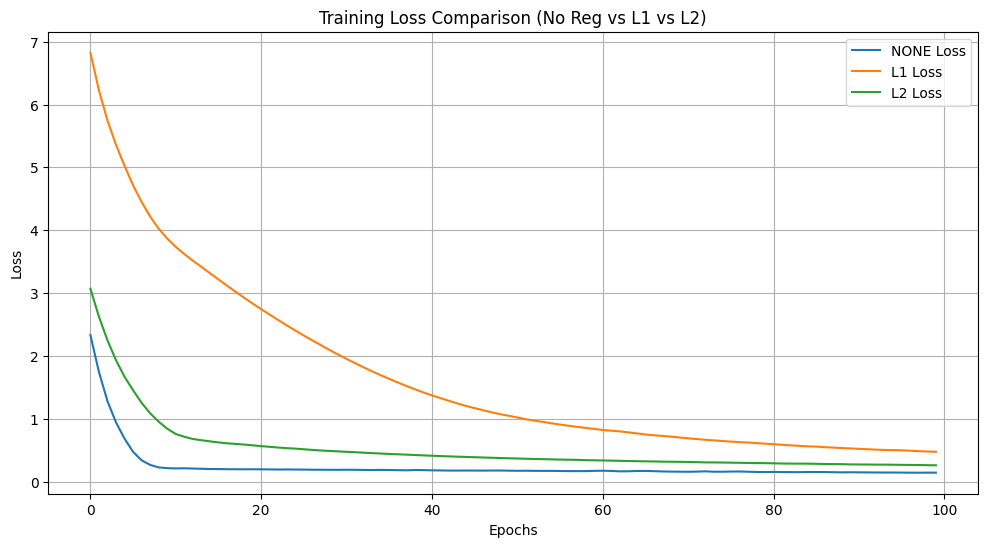

In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np

# Generate synthetic data
X = np.linspace(-3, 3, 100)
y = 0.5 * X + np.sin(X) + np.random.normal(scale=0.3, size=X.shape)

X = X.reshape(-1, 1)
y = y.reshape(-1, 1)

# Build and train models
def build_model(reg_type=None):
    if reg_type == 'l1':
        reg = tf.keras.regularizers.l1(0.01)
    elif reg_type == 'l2':
        reg = tf.keras.regularizers.l2(0.01)
    else:
        reg = None
    model = tf.keras.Sequential([
        tf.keras.layers.Dense(64, activation='relu', kernel_regularizer=reg, input_shape=(1,)),
        tf.keras.layers.Dense(64, activation='relu', kernel_regularizer=reg),
        tf.keras.layers.Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    return model

histories = {}
for name in ['none', 'l1', 'l2']:
    model = build_model(None if name == 'none' else name)
    history = model.fit(X, y, epochs=100, verbose=0)
    histories[name] = (model, history)

# Visualization
plt.figure(figsize=(12, 6))
for name, (model, history) in histories.items():
    plt.plot(history.history['loss'], label=f'{name.upper()} Loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Training Loss Comparison (No Reg vs L1 vs L2)")
plt.legend()
plt.grid(True)
plt.show()


## Task (b): Dropout Regularization

Dropout helps prevent overfitting by randomly turning off neurons during training.  
Here, we demonstrate its effect by comparing a model trained with and without dropout.  
We use a synthetic dataset and visualize how dropout improves generalization on unseen data.


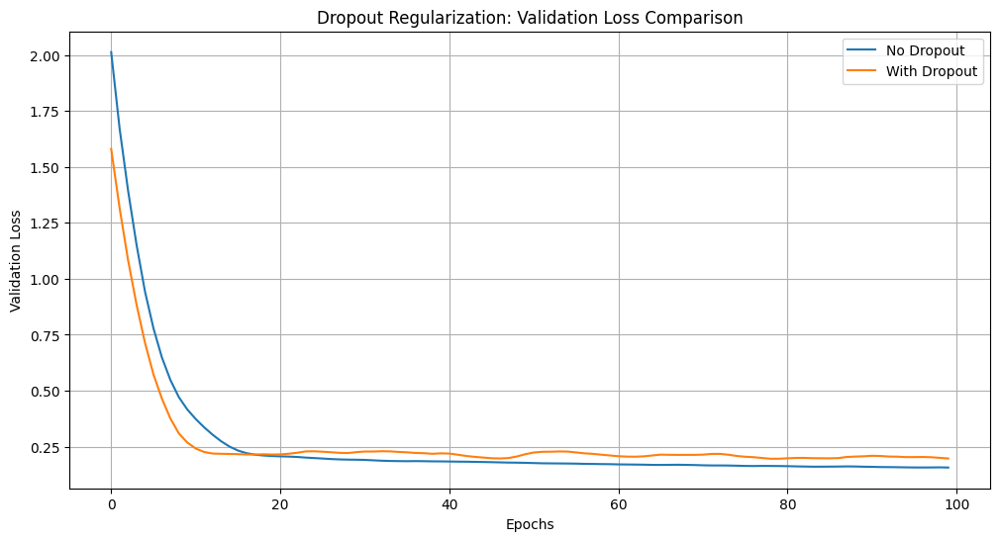

In [ ]:
from sklearn.model_selection import train_test_split

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

# Model with and without dropout
def build_dropout_model(use_dropout=False):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(64, activation='relu', input_shape=(1,)))
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.5))
    model.add(tf.keras.layers.Dense(64, activation='relu'))
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.5))
    model.add(tf.keras.layers.Dense(1))
    model.compile(optimizer='adam', loss='mse')
    return model

model_dropout = build_dropout_model(True)
model_no_dropout = build_dropout_model(False)

hist_drop = model_dropout.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=100, verbose=0)
hist_no_drop = model_no_dropout.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=100, verbose=0)

# Plotting validation loss
plt.figure(figsize=(12, 6))
plt.plot(hist_no_drop.history['val_loss'], label='No Dropout')
plt.plot(hist_drop.history['val_loss'], label='With Dropout')
plt.xlabel("Epochs")
plt.ylabel("Validation Loss")
plt.title("Dropout Regularization: Validation Loss Comparison")
plt.legend()
plt.grid(True)
plt.show()


## Task (c): EarlyStopping Callback

EarlyStopping halts training when the validation performance no longer improves.  
It is useful to prevent overfitting and save compute time.  
In this task, we compare training with and without EarlyStopping and visualize how early stopping helps reduce overfitting.


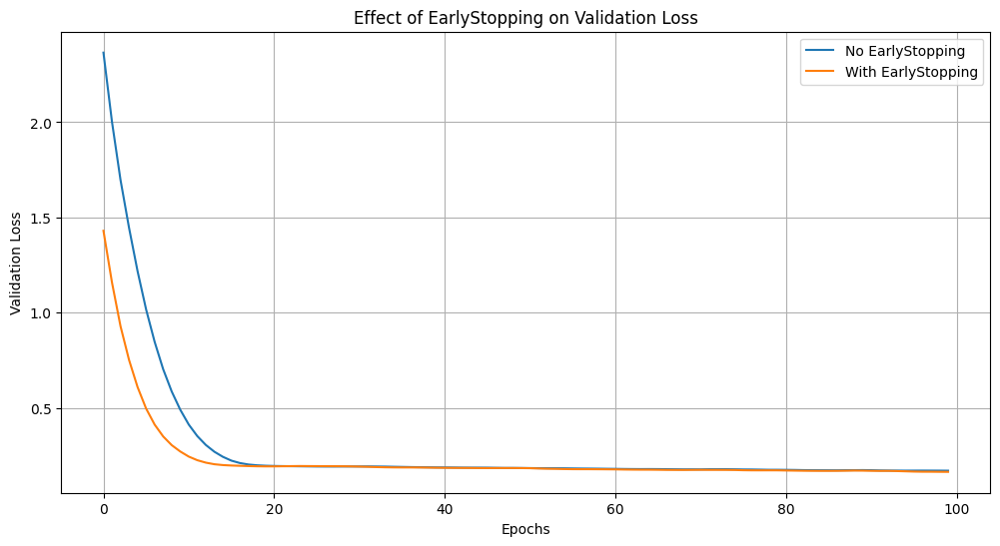

In [ ]:
# Build a simple model
def build_early_model():
    model = tf.keras.Sequential([
        tf.keras.layers.Dense(64, activation='relu', input_shape=(1,)),
        tf.keras.layers.Dense(64, activation='relu'),
        tf.keras.layers.Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    return model

# Without EarlyStopping
model_no_es = build_early_model()
history_no_es = model_no_es.fit(X_train, y_train, validation_data=(X_test, y_test),
                                 epochs=100, verbose=0)

# With EarlyStopping
early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
model_es = build_early_model()
history_es = model_es.fit(X_train, y_train, validation_data=(X_test, y_test),
                          epochs=100, callbacks=[early_stop], verbose=0)

# Visualization
plt.figure(figsize=(12, 6))
plt.plot(history_no_es.history['val_loss'], label='No EarlyStopping')
plt.plot(history_es.history['val_loss'], label='With EarlyStopping')
plt.xlabel("Epochs")
plt.ylabel("Validation Loss")
plt.title("Effect of EarlyStopping on Validation Loss")
plt.legend()
plt.grid(True)
plt.show()


## Task (d): Monte Carlo Dropout

Monte Carlo Dropout enables uncertainty estimation by applying dropout during inference.  
We repeat predictions multiple times with dropout enabled and visualize the distribution of predictions.  
This method is useful for Bayesian-like inference in deep learning.


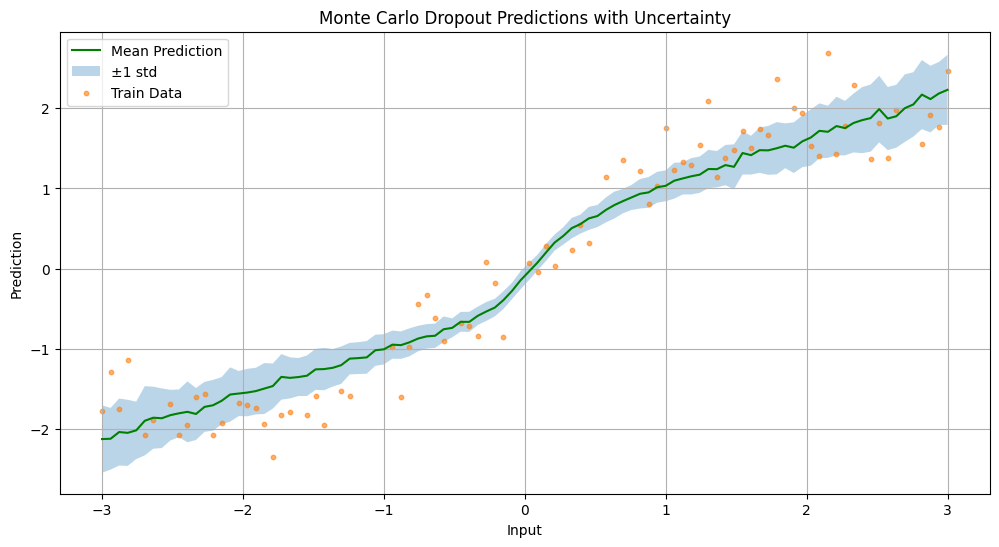

In [ ]:
class MCDropoutModel(tf.keras.Model):
    def __init__(self):
        super().__init__()
        self.d1 = tf.keras.layers.Dense(64, activation='relu')
        self.dropout1 = tf.keras.layers.Dropout(0.3)
        self.d2 = tf.keras.layers.Dense(64, activation='relu')
        self.dropout2 = tf.keras.layers.Dropout(0.3)
        self.out = tf.keras.layers.Dense(1)

    def call(self, x, training=False):
        x = self.d1(x)
        x = self.dropout1(x, training=training)
        x = self.d2(x)
        x = self.dropout2(x, training=training)
        return self.out(x)

# Train the model
mc_model = MCDropoutModel()
mc_model.compile(optimizer='adam', loss='mse')
mc_model.fit(X_train, y_train, epochs=100, verbose=0)

# Predict with dropout (MC sampling)
X_sample = np.linspace(-3, 3, 100).reshape(-1, 1)
predictions = [mc_model(X_sample, training=True).numpy().flatten() for _ in range(100)]

# Visualization: Mean + uncertainty bands
mean_preds = np.mean(predictions, axis=0)
std_preds = np.std(predictions, axis=0)

plt.figure(figsize=(12, 6))
plt.plot(X_sample, mean_preds, label='Mean Prediction', color='green')
plt.fill_between(X_sample.flatten(), mean_preds - std_preds, mean_preds + std_preds, alpha=0.3, label='±1 std')
plt.scatter(X_train, y_train, s=10, label='Train Data', alpha=0.6)
plt.title("Monte Carlo Dropout Predictions with Uncertainty")
plt.xlabel("Input")
plt.ylabel("Prediction")
plt.legend()
plt.grid(True)
plt.show()


## Task (e): Various Initialization Techniques

Weight initialization plays a critical role in training deep neural networks.  
We compare models using different initialization strategies:  
- RandomNormal (default)
- He Normal (good for ReLU)
- Glorot/Xavier (balanced for tanh or sigmoid)

We visualize their training loss to observe how initialization affects convergence speed and stability.


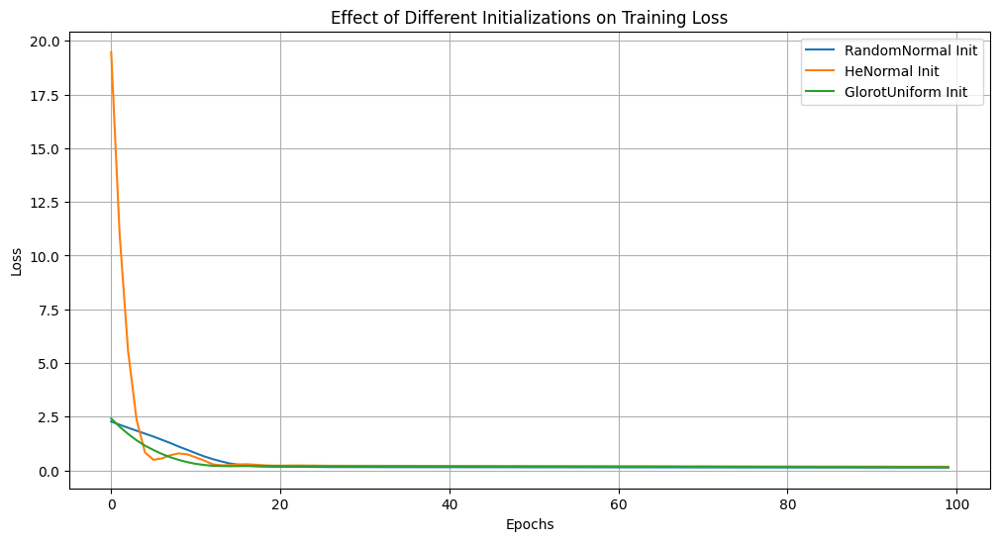

In [ ]:
# Build models with different initializations
def build_init_model(initializer):
    model = tf.keras.Sequential([
        tf.keras.layers.Dense(64, activation='relu', kernel_initializer=initializer, input_shape=(1,)),
        tf.keras.layers.Dense(64, activation='relu', kernel_initializer=initializer),
        tf.keras.layers.Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    return model

inits = {
    "RandomNormal": tf.keras.initializers.RandomNormal(),
    "HeNormal": tf.keras.initializers.HeNormal(),
    "GlorotUniform": tf.keras.initializers.GlorotUniform()
}

histories_init = {}
for name, init in inits.items():
    model = build_init_model(init)
    hist = model.fit(X_train, y_train, epochs=100, verbose=0)
    histories_init[name] = hist

# Visualization
plt.figure(figsize=(12, 6))
for name, hist in histories_init.items():
    plt.plot(hist.history['loss'], label=f'{name} Init')
plt.title("Effect of Different Initializations on Training Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.grid(True)
plt.show()


## Task (f): Batch Normalization

Batch Normalization normalizes intermediate layer outputs during training.  
It improves convergence, reduces internal covariate shift, and can act as regularization.  
We compare models with and without Batch Normalization to visualize its stabilizing effect.


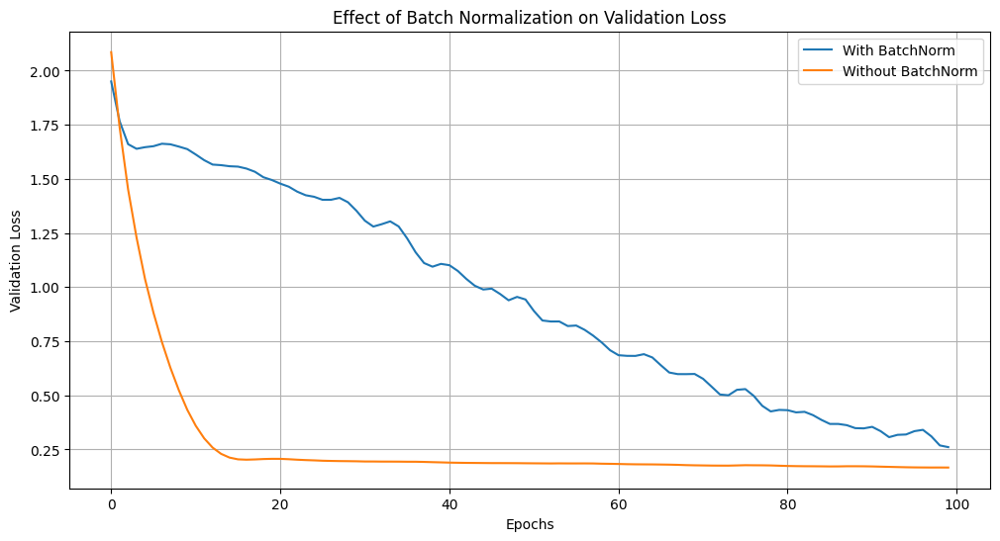

In [ ]:
# Models with and without batch normalization
def build_bn_model(use_bn=False):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(64, input_shape=(1,)))
    if use_bn:
        model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Activation('relu'))

    model.add(tf.keras.layers.Dense(64))
    if use_bn:
        model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Activation('relu'))

    model.add(tf.keras.layers.Dense(1))
    model.compile(optimizer='adam', loss='mse')
    return model

model_with_bn = build_bn_model(True)
model_without_bn = build_bn_model(False)

hist_bn = model_with_bn.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=100, verbose=0)
hist_no_bn = model_without_bn.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=100, verbose=0)

# Visualization
plt.figure(figsize=(12, 6))
plt.plot(hist_bn.history['val_loss'], label='With BatchNorm')
plt.plot(hist_no_bn.history['val_loss'], label='Without BatchNorm')
plt.title("Effect of Batch Normalization on Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Validation Loss")
plt.legend()
plt.grid(True)
plt.show()


## Task (g): Custom Dropout and Custom Regularizer

In this task, we implement:
- A custom dropout layer that mimics standard dropout but with manual control.
- A custom regularizer that penalizes weights based on a specific condition (e.g., L1 + log penalty).

This illustrates the flexibility of TensorFlow to implement specialized regularization logic when needed.


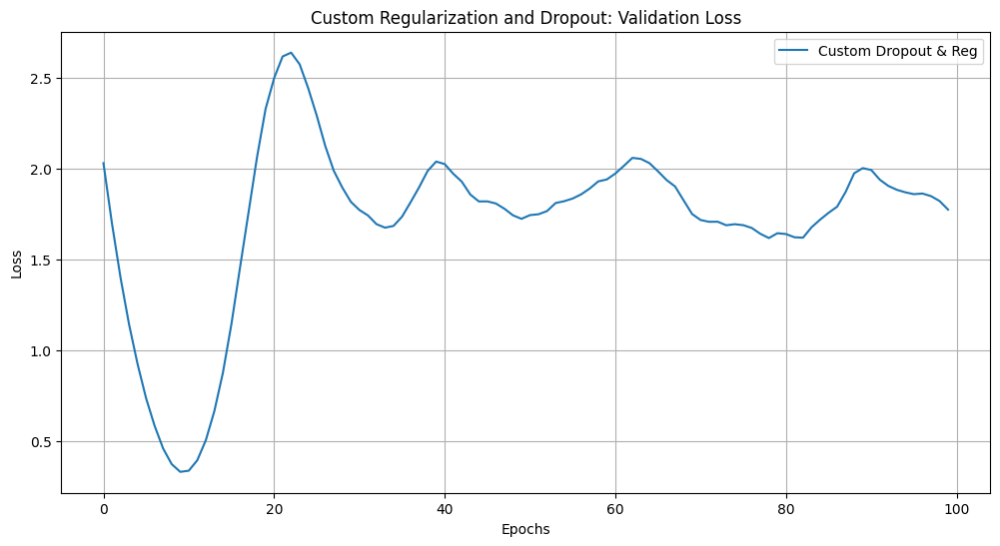

In [ ]:
# Custom Dropout Layer
class MyDropout(tf.keras.layers.Layer):
    def __init__(self, rate):
        super().__init__()
        self.rate = rate

    def call(self, inputs, training=False):
        if training:
            mask = tf.random.uniform(tf.shape(inputs)) >= self.rate
            return tf.where(mask, inputs, tf.zeros_like(inputs))
        return inputs

# Custom Regularizer (L1 + log penalty)
class CustomReg(tf.keras.regularizers.Regularizer):
    def __init__(self, l1=0.01):
        self.l1 = l1

    def __call__(self, x):
        return self.l1 * tf.reduce_sum(tf.abs(x)) + 0.01 * tf.reduce_sum(tf.math.log(1 + tf.square(x)))

# Model using custom layers
def build_custom_model():
    model = tf.keras.Sequential([
        tf.keras.layers.Dense(64, activation='relu', kernel_regularizer=CustomReg(), input_shape=(1,)),
        MyDropout(0.3),
        tf.keras.layers.Dense(64, activation='relu'),
        MyDropout(0.3),
        tf.keras.layers.Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    return model

custom_model = build_custom_model()
history_custom = custom_model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=100, verbose=0)

# Visualization
plt.figure(figsize=(12, 6))
plt.plot(history_custom.history['val_loss'], label='Custom Dropout & Reg')
plt.title("Custom Regularization and Dropout: Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.grid(True)
plt.legend()
plt.show()


## Task (h): Callbacks and TensorBoard Visualization

TensorBoard is a powerful visualization tool for model training and debugging.  
In this task, we use:
- `TensorBoard` to track training metrics in real-time.
- `ReduceLROnPlateau` to adapt learning rate on stagnation.
- `ModelCheckpoint` to save best weights.

Run this in Colab and open the TensorBoard interface using `%tensorboard`.


In [ ]:
import os
import datetime

# Define log directory
log_dir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

# TensorBoard + Callbacks
tensorboard_cb = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
reduce_lr_cb = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', patience=5, factor=0.5, verbose=1)
checkpoint_cb = tf.keras.callbacks.ModelCheckpoint("best_model.h5", save_best_only=True)

# Model for training
model_cb = tf.keras.Sequential([
    tf.keras.layers.Dense(64, activation='relu', input_shape=(1,)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(1)
])
model_cb.compile(optimizer='adam', loss='mse')

# Train with callbacks
model_cb.fit(X_train, y_train,
             validation_data=(X_test, y_test),
             epochs=100,
             callbacks=[tensorboard_cb, reduce_lr_cb, checkpoint_cb],
             verbose=0)





Epoch 16: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.

Epoch 21: ReduceLROnPlateau reducing learning rate to 0.0002500000118743628.


In [ ]:
# View TensorBoard (run in separate cell)
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

## Task (i): Hyperparameter Tuning using Keras Tuner

Keras Tuner helps search for optimal hyperparameters such as number of layers, units, learning rate, etc.  
We define a `HyperModel`, run a random search, and visualize the best model’s performance.  
This task uses a small regression dataset for demonstration.


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 10.5 MB/s eta 0:00:00


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Results summary
Results in my_tuner_dir/regression_tuning
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 3 summary
Hyperparameters:
units: 128
lr: 0.006997708001704712
Score: 0.12347815558314323

Trial 1 summary
Hyperparameters:
units: 32
lr: 0.004160564576348168
Score: 0.15126685053110123

Trial 0 summary
Hyperparameters:
units: 32
lr: 0.003013095794412938
Score: 0.1686800941824913

Trial 2 summary
Hyperparameters:
units: 96
lr: 0.00041139485306494105
Score: 0.2894961088895798

Trial 4 summary
Hyperparameters:
units: 96
lr: 0.00020150308395945987
Score: 0.7351627349853516
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 10 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


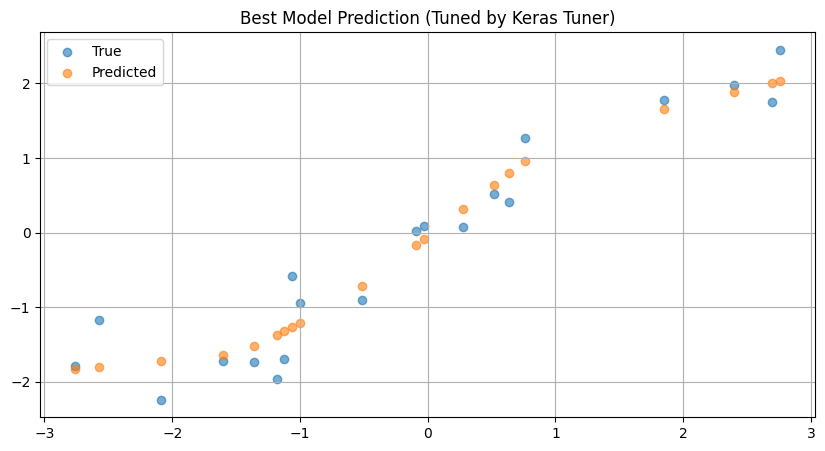

In [ ]:
!pip install -q -U keras-tuner

import keras_tuner as kt

# Define a HyperModel class
def build_model(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(
        units=hp.Int('units', min_value=32, max_value=128, step=32),
        activation='relu',
        input_shape=(1,)
    ))
    model.add(tf.keras.layers.Dense(1))
    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Float('lr', 1e-4, 1e-2, sampling='log')),
        loss='mse'
    )
    return model

# Instantiate tuner
tuner = kt.RandomSearch(
    build_model,
    objective='val_loss',
    max_trials=5,
    executions_per_trial=2,
    directory='my_tuner_dir',
    project_name='regression_tuning'
)

# Search best hyperparameters
tuner.search(X_train, y_train, validation_data=(X_test, y_test), epochs=50, verbose=0)

# Visualize and summarize
best_model = tuner.get_best_models(1)[0]
tuner.results_summary()

# Plot predictions
y_pred = best_model.predict(X_test)
plt.figure(figsize=(10, 5))
plt.scatter(X_test, y_test, label='True', alpha=0.6)
plt.scatter(X_test, y_pred, label='Predicted', alpha=0.6)
plt.title("Best Model Prediction (Tuned by Keras Tuner)")
plt.legend()
plt.grid(True)
plt.show()


## Task (j): Image Classification with KerasCV Augmentations

In this task, we use KerasCV’s `keras_cv.layers` to perform advanced image augmentations like:  
- RandomFlip, RandomRotation, RandomZoom  
We visualize original and augmented images using TensorFlow Datasets and apply them to a simple CNN model.


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 650.7/650.7 kB 12.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 950.8/950.8 kB 44.4 MB/s eta 0:00:00


Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Generating splits...:   0%|          | 0/1 [00:00<?, ? splits/s]

Generating train examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/cats_vs_dogs/incomplete.2I3C5L_4.0.1/cats_vs_dogs-train.tfrecord*...:   0%…

Dataset cats_vs_dogs downloaded and prepared to /root/tensorflow_datasets/cats_vs_dogs/4.0.1. Subsequent calls will reuse this data.


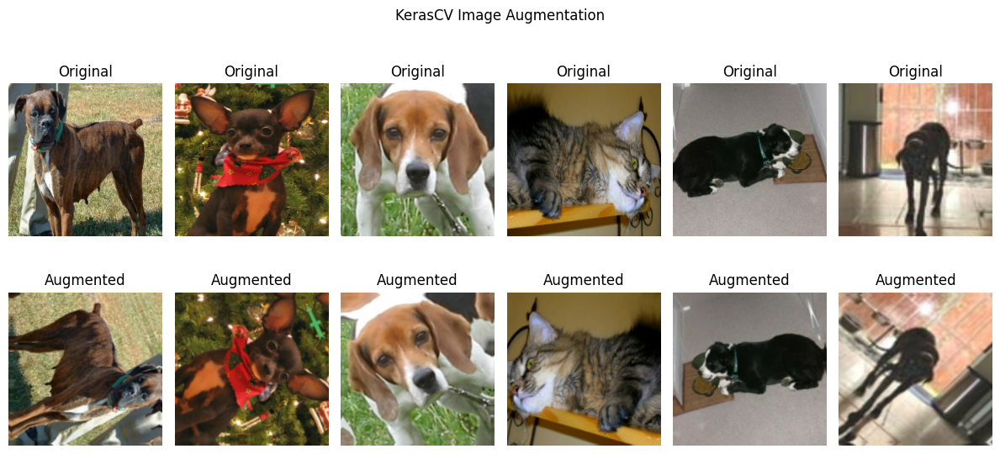

In [ ]:
!pip install -q -U keras-cv
import keras_cv
import tensorflow_datasets as tfds

# Load small dataset (e.g., cats_vs_dogs)
(ds_train, ds_val), ds_info = tfds.load('cats_vs_dogs',
                                        split=['train[:80%]', 'train[80%:]'],
                                        as_supervised=True,
                                        with_info=True)

# Preprocess + resize
def format_image(image, label):
    image = tf.image.resize(image, (224, 224)) / 255.0
    return image, label

ds_train = ds_train.map(format_image).batch(16).prefetch(tf.data.AUTOTUNE)
ds_val = ds_val.map(format_image).batch(16).prefetch(tf.data.AUTOTUNE)

# Apply KerasCV augmentations
augmenter = tf.keras.Sequential([
    keras_cv.layers.RandomFlip(mode="horizontal"),
    keras_cv.layers.RandomRotation(0.2),
    keras_cv.layers.RandomZoom(height_factor=0.1, width_factor=0.1)
])

# Visualize augmentations
sample_images, _ = next(iter(ds_train))
augmented_images = augmenter(sample_images)

plt.figure(figsize=(12, 6))
for i in range(6):
    plt.subplot(2, 6, i + 1)
    plt.imshow(sample_images[i])
    plt.axis("off")
    plt.title("Original")

    plt.subplot(2, 6, i + 7)
    plt.imshow(augmented_images[i])
    plt.axis("off")
    plt.title("Augmented")
plt.suptitle("KerasCV Image Augmentation")
plt.tight_layout()
plt.show()


## Task (k): Cross-Domain Data Augmentation (Text, Image, Audio, Video)
  
- Text (e.g., insert emojis, typos)
- Image (rotate, perspective transform)
- Audio (loudness, speed)
- Video (overlay effects)

This provides robustness in multi-modal machine learning pipelines.


In [ ]:
!pip install augly augly[av]

  Using cached augly-1.0.0-py3-none-any.whl.metadata (9.4 kB)
  Using cached iopath-0.1.10-py3-none-any.whl
Using cached augly-1.0.0-py3-none-any.whl (24.3 MB)


In [ ]:
!sudo apt-get install python3-magic

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  python3-magic
0 upgraded, 1 newly installed, 0 to remove and 34 not upgraded.
Need to get 12.6 kB of archives.
After this operation, 52.2 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 python3-magic all 2:0.4.24-2 [12.6 kB]
Fetched 12.6 kB in 0s (78.9 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package python3-magic.
(Reading database ... 126332 files and dir

In [ ]:
import os
import augly.image as imaugs
import augly.utils as utils
from IPython.display import display
from google.colab import files
from PIL import Image
import io

# Prompt user to upload an image
uploaded = files.upload()

# Load the uploaded image
for fn in uploaded.keys():
    input = Image.open(io.BytesIO(uploaded[fn]))
    print(f"Uploaded image: {fn}")
    break  # Process only the first uploaded image


Saving IMG_0418.jpg to IMG_0418 (1).jpg
Uploaded image: IMG_0418 (1).jpg


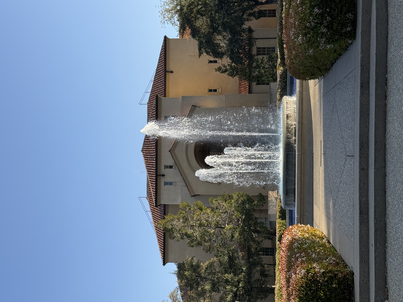

In [ ]:
image = imaugs.scale(input, factor=0.1)
display(image)



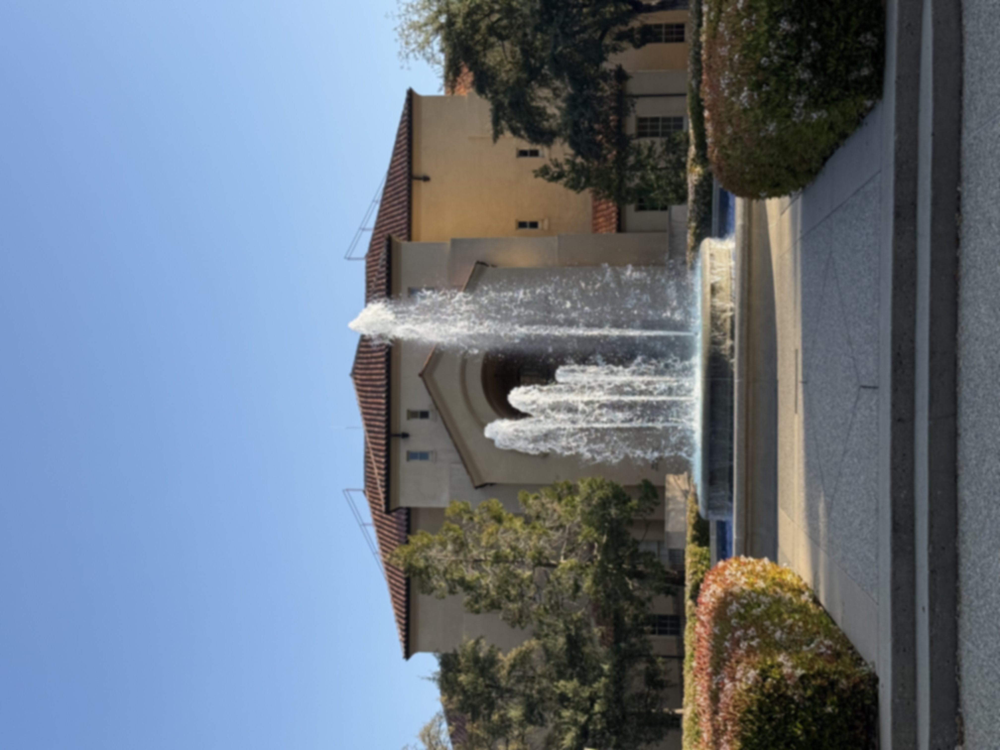

In [ ]:
image = imaugs.blur(input, radius = 4.0)
display(image)

In [ ]:
image = imaugs.brightness(input, factor=1.2)
display(image)

In [ ]:
image = imaugs.brightness(input, factor=0.3)
display(image)

In [ ]:
image = imaugs.contrast(input, factor=2.7)
display(image)

In [ ]:
#horizontal flip
image_h = imaugs.hflip(input)
display(image_h)

#vertical flip
image_v= imaugs.vflip(input)
display(image_v)


In [ ]:
#Grayscale image
image = imaugs.grayscale(input)
display(image)

In [ ]:
# Degrading Image Pixels
image = imaugs.shuffle_pixels(input, factor=0.3)
display(image)

In [ ]:
image = imaugs.skew(input)
display(image)

## Task (l): FastAI Image Augmentations + Test-Time Augmentation (TTA)

FastAI offers powerful and concise tools for:
- Training-time data augmentations using `aug_transforms()`
- Test-Time Augmentation (TTA) for robust prediction via multiple augmented views

In this task, we:
1. Load the Oxford Pets dataset
2. Apply advanced augmentations like warping, zooming, lighting changes
3. Train a CNN (ResNet18)
4. Compare predictions with and without TTA


In [ ]:
! [ -e /content ] && pip install -Uqq fastbook
import fastbook
fastbook.setup_book()

Mounted at /content/gdrive


In [ ]:
from fastbook import *
from fastai.vision.all import *
path = untar_data(URLs.IMAGENETTE)

In [ ]:
dblock = DataBlock(blocks=(ImageBlock(), CategoryBlock()),
                   get_items=get_image_files,
                   get_y=parent_label,
                   item_tfms=Resize(460),
                   batch_tfms=aug_transforms(size=224, min_scale=0.75))
dls = dblock.dataloaders(path, bs=64)

In [ ]:
# Define the model architecture
model = xresnet50(n_out=dls.c)

# Create a Learner instance
learner = Learner(dls, model,
                  loss_func=CrossEntropyLossFlat(),
                  metrics=accuracy)

# Train the model using one cycle policy
learner.fit_one_cycle(n_epoch=5, lr_max=3e-3)

epoch,train_loss,valid_loss,accuracy,time
0,1.622469,3.828684,0.314414,02:41
1,1.209230,1.376512,0.556012,02:34
2,0.951296,0.886343,0.714713,02:33
3,0.728499,0.645872,0.796863,02:33
4,0.598898,0.540783,0.823749,02:33


In [ ]:
x,y = dls.one_batch()
x.mean(dim=[0,2,3]),x.std(dim=[0,2,3])

(TensorImage([0.5075, 0.4826, 0.4501], device='cuda:0'),
 TensorImage([0.2818, 0.2801, 0.3018], device='cuda:0'))

In [ ]:
def get_dls(bs, size):
    dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   get_y=parent_label,
                   item_tfms=Resize(460),
                   batch_tfms=[*aug_transforms(size=size, min_scale=0.75),
                               Normalize.from_stats(*imagenet_stats)])
    return dblock.dataloaders(path, bs=bs)

dls = get_dls(64, 224)


In [ ]:
x,y = dls.one_batch()
x.mean(dim=[0,2,3]),x.std(dim=[0,2,3])

model = xresnet50(n_out=dls.c)
learn = Learner(dls, model, loss_func=CrossEntropyLossFlat(), metrics=accuracy)
learn.fit_one_cycle(5, 3e-3)

epoch,train_loss,valid_loss,accuracy,time
0,1.604193,3.340819,0.343167,02:34
1,1.262979,1.564187,0.529126,02:32
2,0.947543,1.162140,0.656833,02:32
3,0.746497,0.654572,0.796863,02:33
4,0.593111,0.576504,0.817401,02:32


In [ ]:
dls = get_dls(128, 128)
learn = Learner(dls, xresnet50(n_out=dls.c), loss_func=CrossEntropyLossFlat(), metrics=accuracy)
learn.fit_one_cycle(4, 3e-3)
print("---- Initial Training completed ----")


learn.dls = get_dls(64, 224)
learn.fine_tune(5, 1e-3)
print("---- Fine-tuning completed ----")

preds,targs = learn.tta()
acc = accuracy(preds, targs).item()  # Calculate and store accuracy
print("---- Test-Time Augmentation (TTA) Accuracy: {:.4f} ----".format(acc))

epoch,train_loss,valid_loss,accuracy,time
0,1.613193,3.043161,0.390963,02:02
1,1.245918,1.149491,0.664302,02:03
2,0.934356,0.871206,0.733383,02:04
3,0.740606,0.692655,0.783794,02:03


---- Initial Training completed ----


epoch,train_loss,valid_loss,accuracy,time
0,0.828258,1.082496,0.652353,02:34


epoch,train_loss,valid_loss,accuracy,time
0,0.636165,0.779230,0.759522,02:34
1,0.658065,0.688071,0.788648,02:34
2,0.564246,0.586802,0.807692,02:34
3,0.504865,0.474820,0.845780,02:33
4,0.417197,0.454286,0.856983,02:35


---- Fine-tuning completed ----


---- Test-Time Augmentation (TTA) Accuracy: 0.8630 ----


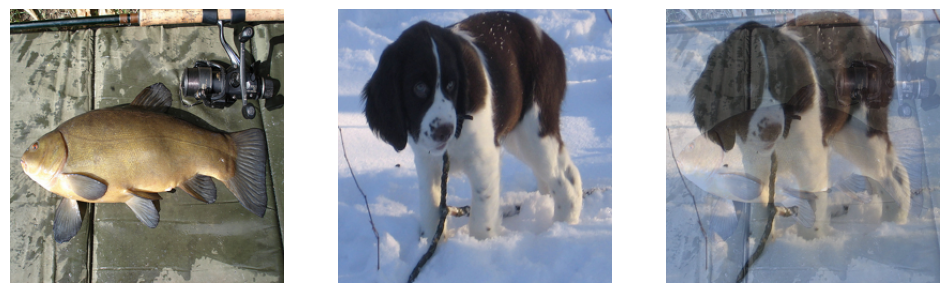

In [ ]:
from fastai.vision.all import *

# Load and resize images (using different categories)
# Replace with other image indices from the respective categories
image1_path = get_image_files_sorted(path/'train'/'n01440764')[30]  # Example: tench, image index 30
image2_path = get_image_files_sorted(path/'train'/'n02102040')[150] # Example: English springer, image index 150

image1 = PILImage.create(image1_path).resize((256, 256))
image2 = PILImage.create(image2_path).resize((256, 256))

# Convert to tensors and normalize
tensor1 = tensor(image1).float() / 255.
tensor2 = tensor(image2).float() / 255.

# Display images
_, axs = plt.subplots(1, 3, figsize=(12, 4))
show_image(tensor1, ax=axs[0]);
show_image(tensor2, ax=axs[1]);
show_image((0.3 * tensor1 + 0.7 * tensor2), ax=axs[2]);